In [1]:
import numpy as np
import matplotlib.pyplot as plt
import librosa.display
import IPython.display as ipd
from scipy.io.wavfile import write
import librosa

In [2]:
music_file = "Signals/Music/Morning Mood.wav"
music_audio, sr = librosa.load(music_file)

In [33]:
def play_audio(audio_data, sample_rate=sr):
    normalized_audio = np.int16(audio_data / np.max(np.abs(audio_data)) * 32767)

    write("temp_audio.wav", sample_rate, normalized_audio)
    return ipd.Audio("temp_audio.wav")

def plot_signal(signal, _sr=sr):
    duration = len(signal) / _sr
    time = np.linspace(0., duration, len(signal))
    plt.plot(time, signal)
    plt.xlabel('Time [s]')
    plt.ylabel('Amplitude')
    plt.grid()
    plt.show()

def plot_spectrogram(signal, _sr=sr):
    S = np.abs(librosa.stft(signal))
    S_db = librosa.amplitude_to_db(S, ref=np.max)

    plt.figure(figsize=(10, 6))
    librosa.display.specshow(S_db, sr=_sr, x_axis="time", y_axis="hz", cmap='magma')
    # set y limit to 2000, and plot in log scale
    plt.ylim(0, 8000)
    plt.colorbar(label="Intensity [dB]")
    plt.title("Spectrogram")
    plt.xlabel("Time [s]")
    plt.ylabel("Frequency [Hz]")
    plt.show()

def extract_period(audio_data, start_time, end_time, sample_rate=sr):
    start_sample = int(start_time * sample_rate)
    end_sample = int(end_time * sample_rate)
    return audio_data[start_sample:end_sample]

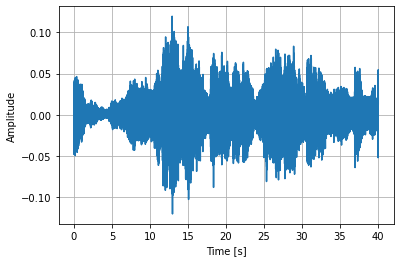

In [4]:
plot_signal(music_audio)

In [5]:
play_audio(music_audio)

In [6]:
regions = []
# divide audio into 10s regions
for i in range(0, len(music_audio), 10 * sr):
    regions.append(music_audio[i:i + 10 * sr])

Region 0


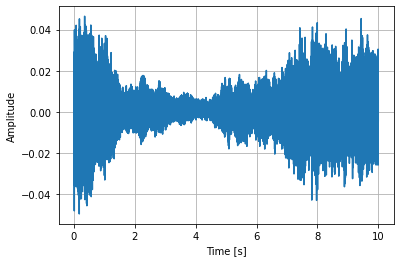

Region 1


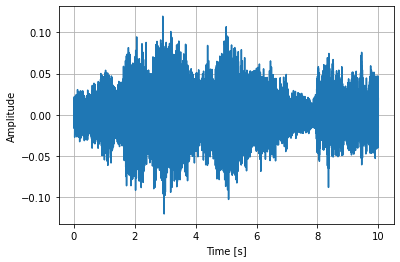

Region 2


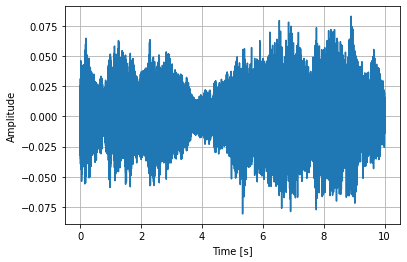

Region 3


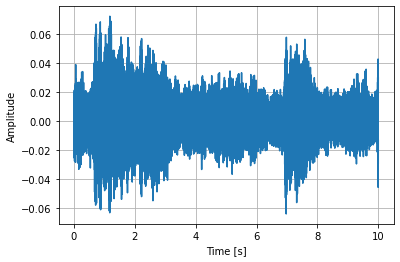

Region 4


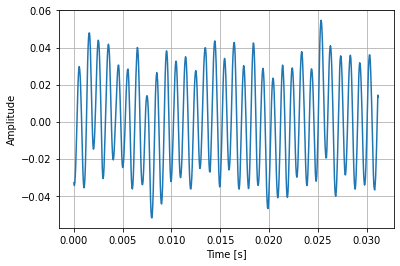

In [7]:
for i, region in enumerate(regions):
    print(f"Region {i}")
    plot_signal(region)

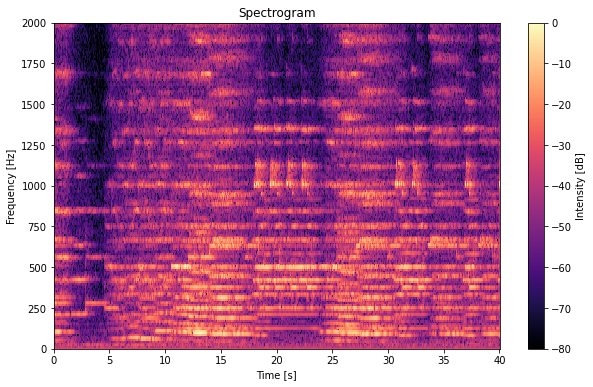

In [8]:
plot_spectrogram(music_audio)

In [9]:
def plot_magnitude_spectrum(ft, freqs):
    plt.plot(freqs, np.abs(ft))
    plt.xlabel('Frequency [Hz]')
    plt.ylabel('Magnitude')
    plt.grid()
    plt.show()

# consider more ranges
# def filter_flute(signal):
#     ft = np.fft.fft(signal)
#     ft = np.fft.fftshift(ft)
#     freqs = np.fft.fftfreq(len(ft), 1/sr)
#     freqs = np.fft.fftshift(freqs)
#     ft[(freqs > 650) & (freqs < 1200)] = 0
#     ft[(freqs < -650) & (freqs > -1200)] = 0
#     plot_magnitude_spectrum(ft, freqs)
#     ft = np.fft.ifftshift(ft)
#     return np.fft.ifft(ft).real

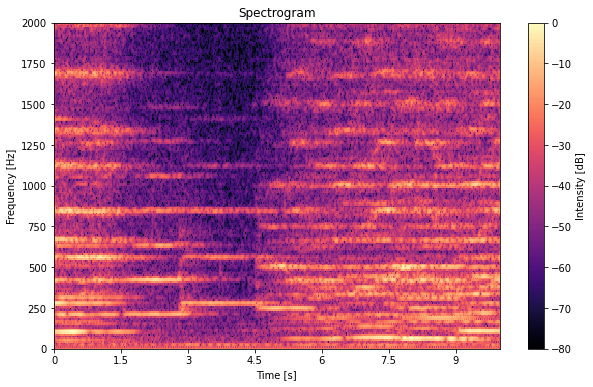

In [10]:
trumpet_part = music_audio[:10 * sr]
plot_spectrogram(trumpet_part)
play_audio(trumpet_part)

In [16]:
def filter_trumpet(signal):
    ft = np.fft.fft(signal)
    ft = np.fft.fftshift(ft)
    freqs = np.fft.fftfreq(len(ft), 1/sr)
    freqs = np.fft.fftshift(freqs)
    ft[(freqs > 160) & (freqs < 350)] = 0
    ft[(freqs < -160) & (freqs > -350)] = 0
    ft[(freqs > 400) & (freqs < 460)] = 0
    ft[(freqs < -400) & (freqs > -460)] = 0
    ft[(freqs > 550) & (freqs < 600)] = 0
    ft[(freqs < -550) & (freqs > -600)] = 0
    ft[(freqs > 800) & (freqs < 900)] = 0
    ft[(freqs < -900) & (freqs > -800)] = 0
    ft[(freqs > 1050) & (freqs < 1150)] = 0
    ft[(freqs < -1050) & (freqs > -1150)] = 0

    plot_magnitude_spectrum(ft, freqs)
    ft = np.fft.ifftshift(ft)
    return np.fft.ifft(ft).real

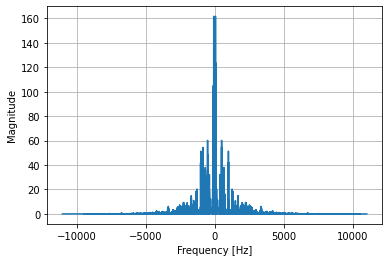

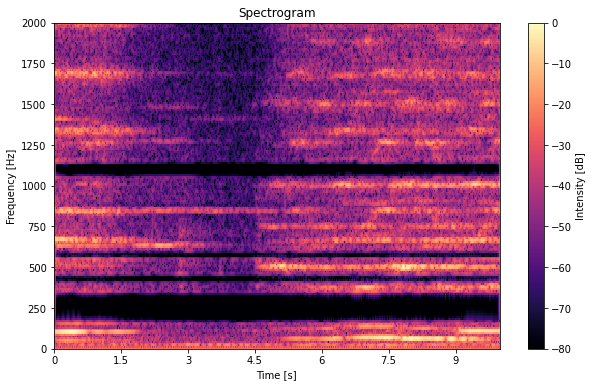

In [17]:
trumpet_part_filtered = filter_trumpet(trumpet_part)
plot_spectrogram(trumpet_part_filtered)
play_audio(trumpet_part_filtered)

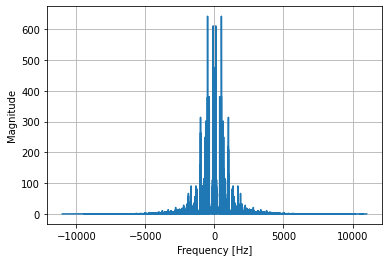

In [18]:
filtered_trumpet_from_signal = filter_trumpet(music_audio)
play_audio(filtered_trumpet_from_signal)

In [19]:
def filter_oboe(signal):
    ft = np.fft.fft(signal)
    ft = np.fft.fftshift(ft)
    freqs = np.fft.fftfreq(len(ft), 1/sr)
    freqs = np.fft.fftshift(freqs)
    ft[(freqs > 950) & (freqs < 1200)] = 0
    ft[(freqs < -950) & (freqs > -1200)] = 0
    ft[(freqs > 1300) & (freqs < 1400)] = 0
    ft[(freqs < -1300) & (freqs > -1400)] = 0

    plot_magnitude_spectrum(ft, freqs)
    ft = np.fft.ifftshift(ft)
    return np.fft.ifft(ft).real

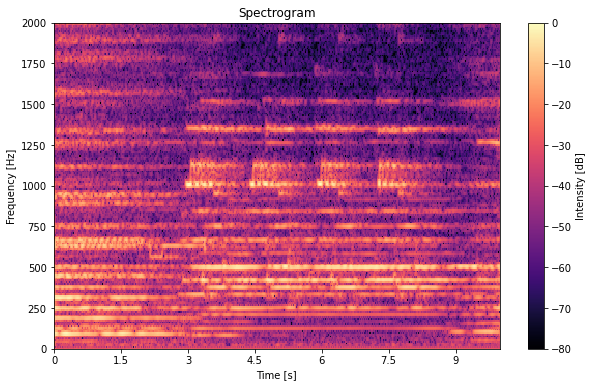

In [20]:
oboe_part = music_audio[15 * sr:25 * sr]
plot_spectrogram(oboe_part)
play_audio(oboe_part)

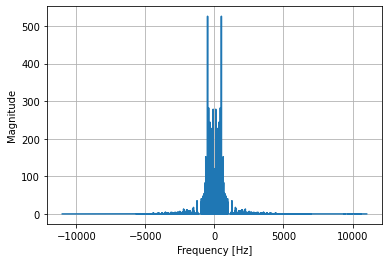

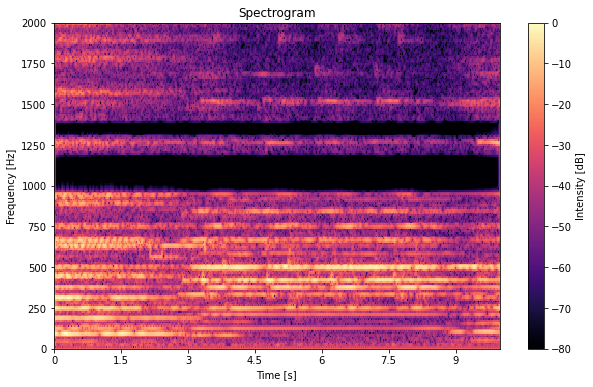

In [21]:
oboe_part_filtered = filter_oboe(oboe_part)
plot_spectrogram(oboe_part_filtered)
play_audio(oboe_part_filtered)

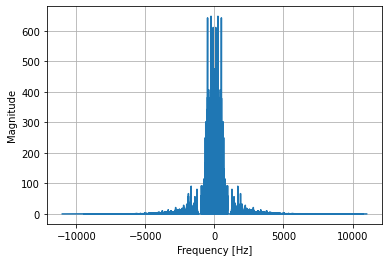

In [22]:
filtered_oboe_from_signal = filter_oboe(music_audio)
play_audio(filtered_oboe_from_signal)

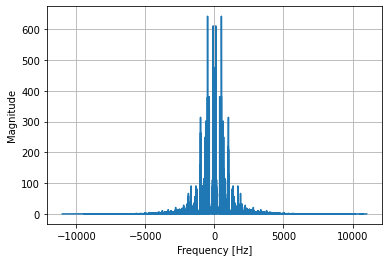

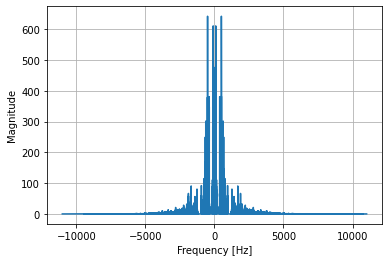

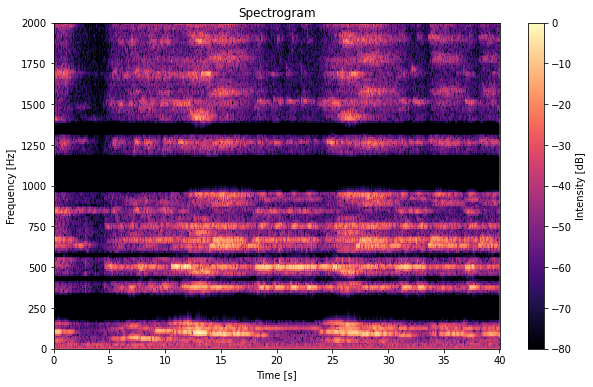

In [23]:
filtered_oboe_and_trumpet = filter_oboe(filter_trumpet(music_audio))
plot_spectrogram(filtered_oboe_and_trumpet)
play_audio(filtered_oboe_and_trumpet)

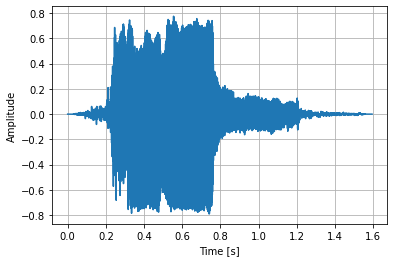

In [24]:
cat_audio, cat_sr = librosa.load("Signals/Music/cat-meow.mp3")
plot_signal(cat_audio, cat_sr)
play_audio(cat_audio, cat_sr)

In [49]:
def filter_cat(signal, sr=cat_sr):
    ft = np.fft.fft(signal)
    ft = np.fft.fftshift(ft)
    freqs = np.fft.fftfreq(len(ft), 1/sr)
    freqs = np.fft.fftshift(freqs)
    ft[(freqs > 550) & (freqs < 660)] = 0
    ft[(freqs < -550) & (freqs > -660)] = 0
    ft[(freqs > 1100) & (freqs < 1300)] = 0
    ft[(freqs < -1100) & (freqs > -1300)] = 0
    ft[(freqs > 1750) & (freqs < 2000)] = 0
    ft[(freqs < -1750) & (freqs > -2000)] = 0
    ft[(freqs > 2300) & (freqs < 2600)] = 0
    ft[(freqs < -2300) & (freqs > -2600)] = 0
    ft[(freqs > 2900) & (freqs < 3200)] = 0
    ft[(freqs < -2900) & (freqs > -3200)] = 0
    ft[(freqs > 3400) & (freqs < 3850)] = 0
    ft[(freqs < -3400) & (freqs > -3850)] = 0
    ft[(freqs > 4050) & (freqs < 4400)] = 0
    ft[(freqs < -4050) & (freqs > -4400)] = 0
    ft[(freqs > 4600) & (freqs < 5100)] = 0
    ft[(freqs < -4600) & (freqs > -5100)] = 0
    ft[(freqs > 5200) & (freqs < 5800)] = 0
    ft[(freqs < -5200) & (freqs > -5800)] = 0

    plot_magnitude_spectrum(ft, freqs)
    ft = np.fft.ifftshift(ft)
    return np.fft.ifft(ft).real

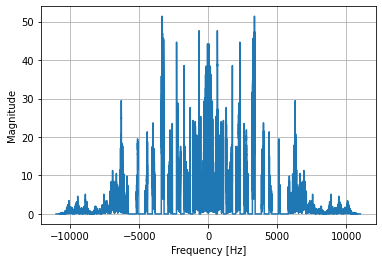

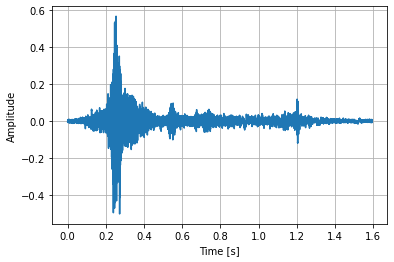

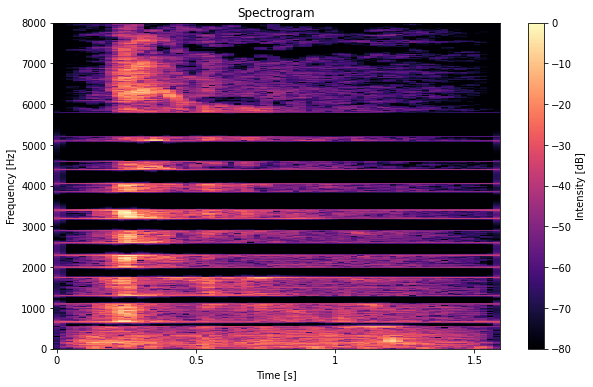

In [50]:
filtered_cat = filter_cat(cat_audio, cat_sr)
plot_signal(filtered_cat, cat_sr)
plot_spectrogram(filtered_cat, cat_sr)
play_audio(filtered_cat, cat_sr)

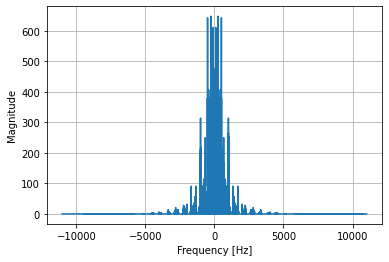

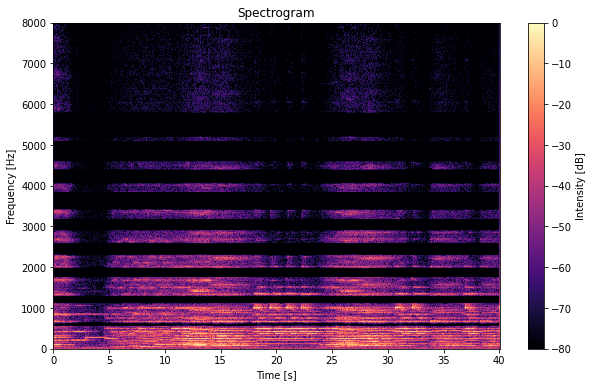

In [51]:
filtered_cat_from_audio = filter_cat(music_audio)
plot_spectrogram(filtered_cat_from_audio)
play_audio(filtered_cat_from_audio)

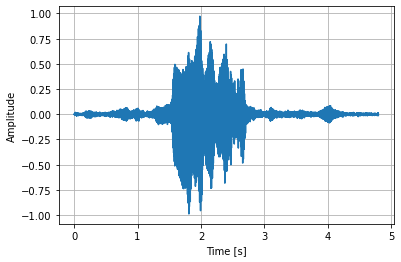

In [56]:
whale_audio, whale_sr = librosa.load("Signals/Music/bowhead-whale.mp3")
plot_signal(whale_audio, whale_sr)
play_audio(whale_audio, whale_sr)

In [59]:
def filter_whale(signal, sr=whale_sr):
    ft = np.fft.fft(signal)
    ft = np.fft.fftshift(ft)
    freqs = np.fft.fftfreq(len(ft), 1/sr)
    freqs = np.fft.fftshift(freqs)
    ft[(freqs > 0) & (freqs < 300)] = 0
    ft[(freqs < -0) & (freqs > -300)] = 0

    plot_magnitude_spectrum(ft, freqs)
    ft = np.fft.ifftshift(ft)
    return np.fft.ifft(ft).real

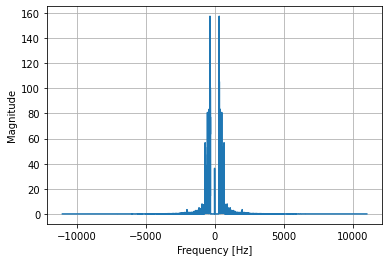

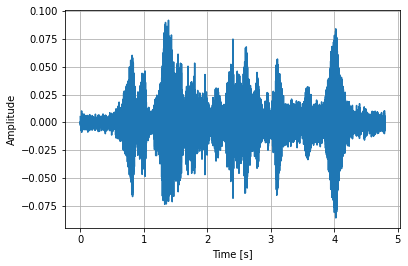

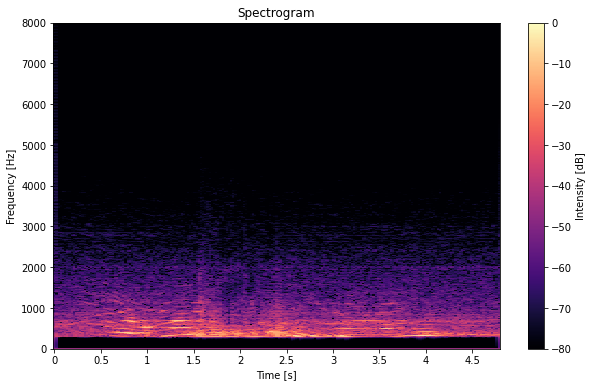

In [60]:
filtered_whale = filter_whale(whale_audio, whale_sr)
plot_signal(filtered_whale, whale_sr)
plot_spectrogram(filtered_whale, whale_sr)
play_audio(filtered_whale, whale_sr)

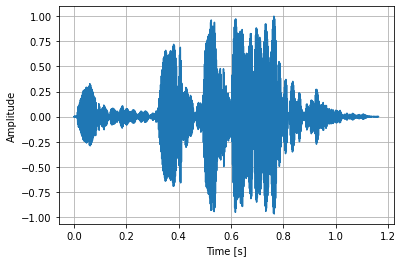

In [61]:
owl_audio, owl_sr = librosa.load("Signals/Music/owl.mp3")
plot_signal(owl_audio, owl_sr)
play_audio(owl_audio, owl_sr)

In [62]:
def filter_owl(signal, sr=owl_sr):
    ft = np.fft.fft(signal)
    ft = np.fft.fftshift(ft)
    freqs = np.fft.fftfreq(len(ft), 1/sr)
    freqs = np.fft.fftshift(freqs)
    ft[(freqs > 310) & (freqs < 420)] = 0
    ft[(freqs < -310) & (freqs > -420)] = 0

    plot_magnitude_spectrum(ft, freqs)
    ft = np.fft.ifftshift(ft)
    return np.fft.ifft(ft).real

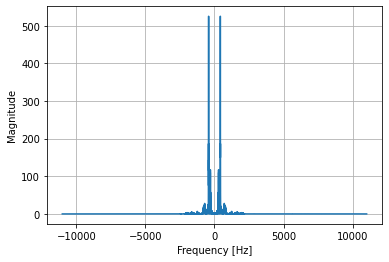

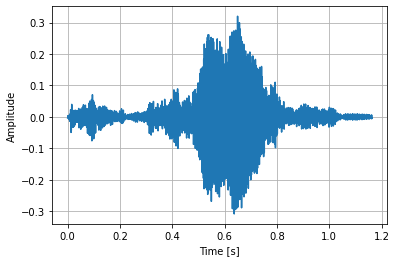

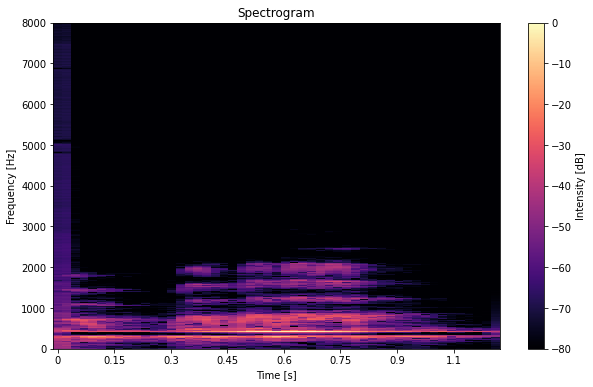

In [64]:
filtered_owl = filter_owl(owl_audio)
plot_signal(filtered_owl, owl_sr)
plot_spectrogram(filtered_owl, owl_sr)
play_audio(filtered_owl, owl_sr)

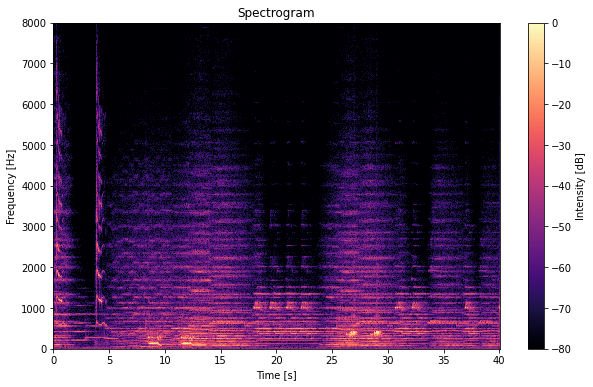

In [65]:
animals_instruments_audio_combined, sr = librosa.load("Signals/Music/Animal Music.wav")
plot_spectrogram(animals_instruments_audio_combined, sr)
play_audio(animals_instruments_audio_combined, sr)

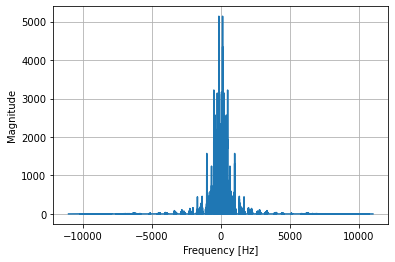

In [66]:
filtered_cat = filter_cat(animals_instruments_audio_combined, sr)
play_audio(filtered_cat, sr)

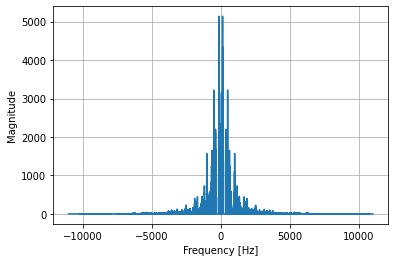

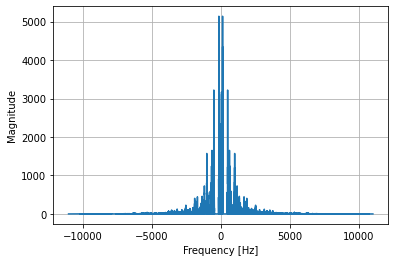

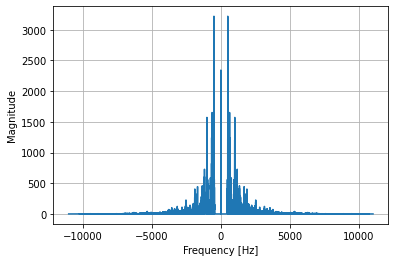

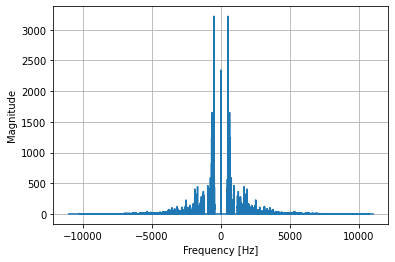

In [67]:
only_cat = filter_oboe((filter_whale(filter_owl(filter_trumpet(animals_instruments_audio_combined)))))
play_audio(only_cat, sr)

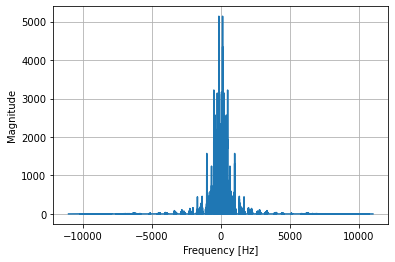

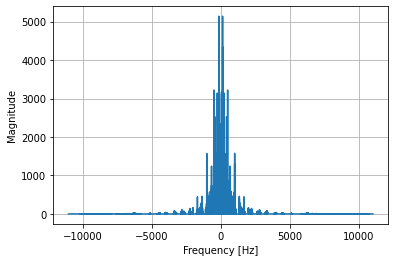

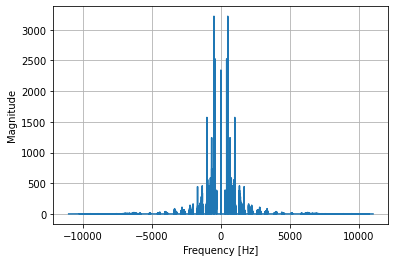

In [68]:
filtered_animals = filter_whale(filter_owl(filter_cat(animals_instruments_audio_combined)))
play_audio(filtered_animals, sr)

In [69]:
play_audio(animals_instruments_audio_combined, sr)